<a href="https://colab.research.google.com/github/deepmind/perception_test/blob/main/baselines/mc_vqa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Copyright 2023 DeepMind Technologies Limited

Licensed under the Apache License, Version 2.0 (the "License");
you may not use this file except in compliance with the License.
You may obtain a copy of the License at [https://www.apache.org/licenses/LICENSE-2.0](https://www.apache.org/licenses/LICENSE-2.0).
Unless required by applicable law or agreed to in writing, software
distributed under the License is distributed on an "AS IS" BASIS,
WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
See the License for the specific language governing permissions and
limitations under the License.


# Multiple-Choice Video Question Answering Baseline

Github: https://github.com/deepmind/perception_test

## The Perception Test
[Perception Test: A Diagnostic Benchmark for Multimodal Video Models](https://arxiv.org/abs/2305.13786) is a multimodal benchmark designed to comprehensively evaluate the perception and reasoning skills of multimodal video models. The Perception Test dataset introduces real-world videos designed to show perceptually interesting situations and defines multiple computational tasks (object and point tracking, action and sound localisation, multiple-choice and grounded video question-answering). Here, we provide details and a simple baseline for the multiple-choice video question-answering task.


## Multiple-choice video question answering (mc-vQA)
For this task, the model receives a video, a question, and three possible answers, out of which only one is correct, and the model has to pick one answer. Performance is evaluated by measuring top-1 accuracy.

The questions cover four skill areas (*Memory*, *Abstraction*, *Physics*, *Semantics*), and require different types of reasoning (*Descriptive*, *Explanatory*, *Predictive*, *Counterfactual*).

Example of skills in different areas: event recall (Memory), object counting (Abstraction), collision (Physics), action recognition (Semantics) and more.

See below examples of videos and multiple-choice question-answers.

## Dummy frequency-based baseline
This notebook demonstrates how to load the mc-vQA annotations in the validation split of the Perception Test and run the evaluation for a dummy baseline model, which uses the frequency of answers in the training set to predict the answers for the validation set.

[![Perception Test Overview Presentation](https://img.youtube.com/vi/8BiajMOBWdk/maxresdefault.jpg)](https://youtu.be/8BiajMOBWdk?t=62)


In [1]:
# @title Prerequisites
import collections
import json
import os
import random
from typing import List, Dict, Any, Tuple
import zipfile

import cv2
from matplotlib import patches
from matplotlib.path import Path
from matplotlib.projections import register_projection
from matplotlib.projections.polar import PolarAxes
import matplotlib.pyplot as plt
from matplotlib.spines import Spine
from matplotlib.transforms import Affine2D
import moviepy.editor as mvp
import numpy as np
import requests

In [2]:
# @title Utility Functions
def download_and_unzip(url: str, destination: str):
  """Downloads and unzips a .zip file to a destination.

  Downloads a file from the specified URL, saves it to the destination
  directory, and then extracts its contents.

  If the file is larger than 1GB, it will be downloaded in chunks,
  and the download progress will be displayed.

  Args:
    url (str): The URL of the file to download.
    destination (str): The destination directory to save the file and
      extract its contents.
  """
  if not os.path.exists(destination):
    os.makedirs(destination)

  filename = url.split('/')[-1]
  file_path = os.path.join(destination, filename)

  if os.path.exists(file_path):
    print(f'{filename} already exists. Skipping download.')
    return

  response = requests.get(url, stream=True)
  total_size = int(response.headers.get('content-length', 0))
  gb = 1024*1024*1024

  if total_size / gb > 1:
    print(f'{filename} is larger than 1GB, downloading in chunks')
    chunk_flag = True
    chunk_size = int(total_size/100)
  else:
    chunk_flag = False
    chunk_size = total_size

  with open(file_path, 'wb') as file:
    for chunk_idx, chunk in enumerate(
        response.iter_content(chunk_size=chunk_size)):
      if chunk:
        if chunk_flag:
          print(f"""{chunk_idx}% downloading
          {round((chunk_idx*chunk_size)/gb, 1)}GB
          / {round(total_size/gb, 1)}GB""")
        file.write(chunk)
  print(f"'{filename}' downloaded successfully.")

  with zipfile.ZipFile(file_path, 'r') as zip_ref:
    zip_ref.extractall(destination)
  print(f"'{filename}' extracted successfully.")

  os.remove(file_path)


def load_db_json(db_file: str) -> Dict[str, Any]:
  """Loads a JSON file as a dictionary.

  Args:
    db_file (str): Path to the JSON file.

  Returns:
    Dict: Loaded JSON data as a dictionary.

  Raises:
    FileNotFoundError: If the specified file doesn't exist.
    TypeError: If the JSON file is not formatted as a dictionary.
  """
  if not os.path.isfile(db_file):
    raise FileNotFoundError(f'No such file: {db_file}')

  with open(db_file, 'r') as f:
    db_file_dict = json.load(f)
    if not isinstance(db_file_dict, dict):
      raise TypeError('JSON file is not formatted as a dictionary.')
    return db_file_dict


def load_mp4_to_frames(filename: str) -> np.array:
  """Loads an MP4 video file and returns its frames as a NumPy array.

  Args:
    filename (str): Path to the MP4 video file.

  Returns:
    np.array: Frames of the video as a NumPy array.
  """
  assert os.path.exists(filename), f'File {filename} does not exist.'
  cap = cv2.VideoCapture(filename)

  num_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
  height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
  width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))

  vid_frames = np.empty((num_frames, height, width, 3), dtype=np.uint8)

  idx = 0
  while True:
    ret, frame = cap.read()
    if not ret:
      break

    vid_frames[idx] = frame
    idx += 1

  cap.release()
  return vid_frames


def get_video_frames(data_item: Dict[str, Any],
                     video_folder_path: str) -> np.array:
  """Loads frames of a video specified by an item dictionary.

  Assumes format of annotations used in the Perception Test Dataset.

  Args:
    data_item (Dict): Item from dataset containing metadata.
    video_folder_path (str): Path to the directory containing videos.

  Returns:
    np.array: Frames of the video as a NumPy array.
  """
  video_file = os.path.join(video_folder_path,
                            data_item['metadata']['video_id']) + '.mp4'
  vid_frames = load_mp4_to_frames(video_file)
  assert data_item['metadata']['num_frames'] == vid_frames.shape[0]
  return vid_frames

In [3]:
# @title Download Data
data_path = './data/'

# sample annotations and videos the visualise the annotations later
sample_annot_url = 'https://storage.googleapis.com/dm-perception-test/zip_data/sample_annotations.zip'
download_and_unzip(sample_annot_url, data_path)
sample_videos_url = 'https://storage.googleapis.com/dm-perception-test/zip_data/sample_videos.zip'
download_and_unzip(sample_videos_url, data_path)

# validation set annotations to perform tracking
valid_annot_url = 'https://storage.googleapis.com/dm-perception-test/zip_data/mc_question_valid_annotations.zip'
download_and_unzip(valid_annot_url, data_path)
# validation set annotations to perform tracking
train_annot_url = 'https://storage.googleapis.com/dm-perception-test/zip_data/mc_question_train_annotations.zip'
download_and_unzip(train_annot_url, data_path)

# validation videos not downloaded because they are too big (approx 70GB).
# not needed for this baseline since we are choosing answers based on the
# frequency of oocurence we do not actually need the videos to calculate
# the performance.
# valid_videos_url =
# 'https://storage.googleapis.com/dm-perception-test/zip_data/valid_videos.zip'
# download_and_unzip(valid_videos_url, data_path)

valid_db_path = './data/mc_question_valid.json'
train_db_path = './data/mc_question_train.json'

# # load dataset annotations to dictionary
valid_db_dict = load_db_json(valid_db_path)
train_db_dict = load_db_json(train_db_path)

'sample_annotations.zip' downloaded successfully.
'sample_annotations.zip' extracted successfully.
'sample_videos.zip' downloaded successfully.
'sample_videos.zip' extracted successfully.
'mc_question_valid_annotations.zip' downloaded successfully.
'mc_question_valid_annotations.zip' extracted successfully.
'mc_question_train_annotations.zip' downloaded successfully.
'mc_question_train_annotations.zip' extracted successfully.


In [4]:
# @title Display Example Video
video_path = './data/videos/'
video_id = 'video_8241'
video_item = valid_db_dict[video_id]
video_path = os.path.join(video_path,
                          video_item['metadata']['video_id']) + '.mp4'
display(mvp.ipython_display(video_path))

print('Video ID: ', video_item['metadata']['video_id'])
print('Video Length: ', video_item['metadata']['num_frames'])
print('Video FPS: ', video_item['metadata']['frame_rate'])
print('Video  Resolution: ', video_item['metadata']['resolution'])

Video ID:  video_8241
Video Length:  782
Video FPS:  29.8257999420166
Video  Resolution:  [1080, 1920]


In [5]:
# @title Ground Truth Annotations Visualised
# get sample video info to showcase the annotations
if video_item['mc_question']:
  for example_q in video_item['mc_question']:
    print('---------------------------------')
    print('Question: ', example_q['question'])
    print('Options: ', example_q['options'])
    print('Answer ID: ', example_q['answer_id'])
    print('Answer: ', example_q['options'][example_q['answer_id']])
    print('Question info: ')
    print('Reasoning: ', example_q['reasoning'])
    print('Tag: ', example_q['tag'])
    print('area: ', example_q['area'])
    print('---------------------------------')

---------------------------------
Question:  Which of the following statements describes the scene better?
Options:  ['There is an egg in the cup of sugar.', 'There is an egg next to the cup of sugar.', 'There is an egg in the teabox.']
Answer ID:  0
Answer:  There is an egg in the cup of sugar.
Question info: 
Reasoning:  descriptive
Tag:  ['spatial relations', 'language', 'object recognition']
area:  physics
---------------------------------
---------------------------------
Question:  What is the order of the letters at the end?
Options:  ['omra', 'rmoa', 'amor']
Answer ID:  2
Answer:  amor
Question info: 
Reasoning:  descriptive
Tag:  ['spatial relations', 'sequencing', 'object recognition']
area:  physics
---------------------------------
---------------------------------
Question:  What was the order of the letters at the beginning?
Options:  ['maro', 'moar', 'amor']
Answer ID:  2
Answer:  amor
Question info: 
Reasoning:  descriptive
Tag:  ['object recognition', 'spatial relation

In [6]:
# @title Dataset Class
class PerceptionDataset():
  """Dataset class to store video items from dataset.

  Attributes:
    video_folder: Path to the folder containing the videos.
    task: Task type for annotations.
    split: Dataset split to load.
    pt_db_list: List containing annotations for dataset according to
      split and task availability.
  """

  def __init__(self, pt_db_dict: Dict[str, Any], video_folder: str,
               task: str, split: str) -> None:
    """Initializes the PerceptionDataset class.

    Args:
      pt_db_dict (Dict): Dictionary containing annotations for dataset.
      video_folder (str): Path to the folder containing the videos.
      task (str): Task type for annotations.
      split (str): Dataset split to load.
    """
    self.video_folder = video_folder
    self.task = task
    self.split = split
    self.pt_db_list = self.load_dataset(pt_db_dict)

  def load_dataset(self, pt_db_dict: Dict[str, Any]) -> List[Dict[str, Any]]:
    """Loads the dataset from the annotation file and processes.

    Dict is processed according to split and task.

    Args:
      pt_db_dict: (Dict): Dictionary containing
        annotations.

    Returns:
      List: List of database items containing annotations.
    """
    pt_db_list = []
    for _, v in pt_db_dict.items():
      if v['metadata']['split'] == self.split:
        if v[self.task]:  # If video has annotations for this task
          pt_db_list.append(v)

    return pt_db_list

  def __len__(self) -> int:
    """Returns the total number of videos in the dataset.

    Returns:
      int: Total number of videos.
    """
    return len(self.pt_db_list)

  def __getitem__(self, idx: int) -> Dict[str, Any]:
    """Returns the video and annotations for a given index.

      example_annotation = {
        'video_10909':{
          'mc_question': [
            {'id': 0, 'question': 'Is the camera moving or static?',
                  'options': ["I don't know", 'moving', 'static or shaking'],
                  'answer_id': 2, 'area': 'physics', 'reasoning': 'descriptive',
                  'tag': ['motion']
            }
          ]
        }
      }

    Args:
      idx (int): Index of the video.

    Returns:
      Dict: Dictionary containing the video frames, metadata, annotations.
    """
    data_item = self.pt_db_list[idx]
    annot = data_item[self.task]
    metadata = data_item['metadata']
    # here we are loading a placeholder as the frames
    # the commented out function below will actually load frames
    vid_frames = np.zeros((metadata['num_frames'], 1, 1, 1))
    # frames = get_video_frames(video_item, self.video_folder)

    return {'metadata': metadata,
            self.task: annot,
            'frames': vid_frames}

In [7]:
# @title Fixed Categories for Evaluation
AREA = ['physics', 'semantics', 'abstraction', 'memory']
REASONING = ['descriptive', 'counterfactual', 'explanatory', 'predictive']
TAG = ['motion', 'place recognition', 'action counting', 'spatial relations',
       'object recognition', 'action recognition', 'distractor action',
       'distractor object', 'state recognition', 'object counting',
       'change detection', 'sequencing', 'task completion',
       'adversarial action', 'collision', 'object attributes',
       'pattern breaking', 'feature matching', 'pattern discovery',
       'part recognition', 'material', 'event recall', 'containment',
       'occlusion', 'solidity', 'object permanence', 'colour recognition',
       'conservation', 'quantity', 'event counting', 'language',
       'visual discrimination', 'general knowledge', 'stability']

TAG_AREA = {
    'change detection': 'memory',
    'event recall': 'memory',
    'sequencing': 'memory',
    'visual discrimination': 'memory',
    'action counting': 'abstraction',
    'event counting': 'abstraction',
    'feature matching': 'abstraction',
    'object counting': 'abstraction',
    'pattern breaking': 'abstraction',
    'pattern discovery': 'abstraction',
    'collision': 'physics',
    'conservation': 'physics',
    'containment': 'physics',
    'material': 'physics',
    'motion': 'physics',
    'occlusion': 'physics',
    'object attributes': 'physics',
    'object permanence': 'physics',
    'quantity': 'physics',
    'solidity': 'physics',
    'spatial relations': 'physics',
    'stability': 'physics',
    'action recognition': 'semantics',
    'adversarial action': 'semantics',
    'colour recognition': 'semantics',
    'distractor action': 'semantics',
    'distractor object': 'semantics',
    'general knowledge': 'semantics',
    'language': 'semantics',
    'object recognition': 'semantics',
    'part recognition': 'semantics',
    'place recognition': 'semantics',
    'state recognition': 'semantics',
    'task completion': 'semantics',
}

CAT = AREA + REASONING + TAG

In [8]:
# @title Evaluation Function
def calc_top1(answers_dict: Dict[str, Any],
              db_dict: Dict[str, Any]) -> float:
  """Calculates the top-1 accuracy and results for each category.

  Args:
    answers_dict (Dict): Dictionary containing the answers.
    db_dict (Dict): Dictionary containing the database.

  Returns:
    float: Top-1 accuracy.

  Raises:
    KeyError: Raises error if the results contain a question ID that does not
      exist in the annotations.
    ValueError: Raises error if the answer ID is outside the expected range
      [0,2].
    ValueError: Raises error if the text of the answer in the results does not
      match the expected string answer in the annotations.
    ValueError: If answers are missing from the results.

  """
  expected_total = 0
  total_correct = 0
  total = 0

  for v in db_dict.values():
    expected_total += len(v['mc_question'])

  for vid_id, vid_answers in answers_dict.items():
    for answer_info in vid_answers:
      answer_id = answer_info['answer_id']
      question_idx = answer_info['id']

      try:
        ground_truth = db_dict[vid_id]['mc_question'][question_idx]
      except KeyError as exc:
        raise KeyError('Unexpected question ID in answer.') from exc

      if answer_id > 2 or answer_id < 0:
        raise ValueError(f'Answer ID must be in range [0:2], got {answer_id}.')
      if ground_truth['options'][answer_id] != answer_info['answer']:
        raise ValueError('Answer text is not as expected.')

      gt_answer_id = ground_truth['answer_id']
      val = int(gt_answer_id == answer_id)
      total_correct += val
      total += 1

  if expected_total != total:
    raise ValueError('Missing answers in results.')

  return total_correct/total


def calc_top1_by_cat(answers_dict: Dict[str, Any],
                     db_dict: Dict[str, Any]) -> Dict[str, Any]:
  """Calculates the top-1 accuracy and results for each category.

  Args:
    answers_dict (Dict): Dictionary containing the answers.
    db_dict (Dict): Dictionary containing the database.

  Returns:
    Dict: Top-1 accuracy and results for each category.
  """
  results_dict = {k: v for k, v in zip(CAT, np.zeros((len(CAT), 2)))}

  for vid_id, vid_answers in answers_dict.items():
    for answer_info in vid_answers:
      answer_id = answer_info['answer_id']
      question_idx = answer_info['id']
      ground_truth = db_dict[vid_id]['mc_question'][question_idx]
      gt_answer_id = ground_truth['answer_id']
      val = int(gt_answer_id == answer_id)

      used_q_areas = []
      q_areas = [TAG_AREA[tag] for tag in ground_truth['tag']]
      for a in q_areas:
        if a not in used_q_areas:
          results_dict[a][0] += val
          results_dict[a][1] += 1
          used_q_areas.append(a)

      results_dict[ground_truth['reasoning']][0] += val
      results_dict[ground_truth['reasoning']][1] += 1
      for t in ground_truth['tag']:
        results_dict[t][0] += val
        results_dict[t][1] += 1

  results_dict = {k: v[0]/v[1] for k, v in results_dict.items()}
  return results_dict

In [9]:
# @title Multiple Choice VQA Model (Frequency Baseline)
class FreqMCVQABaseline:
  """Multiple-Choice vQA Model (Frequency Baseline).

  Attributes:
    answer_db: Dictionary containing the question: answer database.
  """

  def __init__(self, db_dict: Dict[str, Any]):
    """Initializes the MCVQA class.

    Args:
      db_dict (Dict): Dictionary containing the database.
    """
    self.answer_db = self.build_answer_db(db_dict)

  def build_answer_db(self, db_dict: Dict[str, Any]) -> Dict[str, Any]:
    """Builds a answer database.

    Returns a dictionary where the key is the question string and the value
    is a list of strings, each string a correct answer to a previous
    instance of the question.

    Args:
    	db_dict (Dict): Dictionary containing the database of
    		questions and corresponding answers.

    Returns:
    	Dict[str, Any]: Dictionary where the key is question string and
    	the value is list of full correct answers each time that question
    	was asked in the db_dict.
    """
    question_db = {}
    for vid in db_dict.values():
      for question in vid['mc_question']:
        try:
          question_db[question['question']]
        except KeyError:
          question_db[question['question']] = []

        answer = question['options'][question['answer_id']]
        question_db[question['question']].append(answer)

    return question_db

  def random_answer(self, question: Dict[str, Any]) -> Tuple[int, str]:
    """Answer a mc question with a random valid answer.

    Picks a random answer for a multiple choice question.

    Args:
      question (Dict): Question.

    Returns:
      Tuple: Answer ID and answer text.
    """
    answer = random.sample(question['options'], 1)[0]
    answer_id = question['options'].index(answer)
    return answer_id, answer

  def answer_q(self, frames: np.array, question: Dict[str, Any],
               shots: int) -> Tuple[int, str]:
    """Answer a multiple choice question.

    Given a number of shots n, we sample at random n correct answers from the
    training set, then we count the number of occurrences for each of the
    options of the given question and keep the most popular answer (the answer
    with the highest count). For multiple equally popular options, we sample
    one at random.

    Args:
      frames: Video frames (placeholder, unused).
      question (Dict): Question.
      shots: Number of shots for multi-shot answer selection. If 0, random
      sampling is used, if -1, full population is using, else if n, uses sample
      size n of population.

    Returns:
      Tuple: Answer ID and answer text.

    """
    del frames  # unused
    assert shots >= -1

    # sample answers to current question from stored db
    answer_sample = self.answer_db[question['question']]

    if shots == 0:
      return self.random_answer(question)
    elif shots == -1 or shots > len(answer_sample):
      sample_size = len(answer_sample)
    else:
      sample_size = shots

    # get subsample
    answer_subsample = random.sample(answer_sample, sample_size)

    # count frequency of valid answers
    option_freq = []
    for option in question['options']:
      option_freq.append(answer_subsample.count(option))

    # check if more than one answer has same occurence
    max_val = max(option_freq)
    indices = [i for i, value in enumerate(option_freq) if value == max_val]

    # if true sample from the indices
    if len(indices) > 1:
      answer_id = random.sample(indices, 1)[0]
    else:
      answer_id = indices[0]

    answer = question['options'][answer_id]
    return answer_id, answer

In [10]:
# @title Evaluate Static Baseline
cfg = {'video_folder': './data/videos/',
       'task': 'mc_question',
       'split': 'valid'}

test_runs = 5
num_shots = [0, 8, -1]  # 0 shot is random
# init dataset
mc_vqa_dataset = PerceptionDataset(valid_db_dict, **cfg)
# init model
model = FreqMCVQABaseline(train_db_dict)

results = {}
for shots in num_shots:
  test_results = []
  test_results_dict = {k: v for k, v in zip(CAT, np.zeros((len(CAT))))}

  for run in range(test_runs):
    answers = {}

    for video_item in mc_vqa_dataset:
      video_id = video_item['metadata']['video_id']
      video_answers = []

      for q_idx, q in enumerate(video_item['mc_question']):
        # model inference
        q_answer_id, q_answer = model.answer_q(video_item['frames'], q, shots)
        answer_dict = {
            'id': q['id'],
            'answer_id': q_answer_id,
            'answer': q_answer
        }
        video_answers.append(answer_dict)
      answers[video_id] = video_answers

    # calc overall top-1
    top1 = calc_top1(answers, valid_db_dict)
    # calc top-1 by area, reasoning and tag
    run_results_dict = calc_top1_by_cat(answers, valid_db_dict)
    for cat, cat_score in run_results_dict.items():
      test_results_dict[cat] += cat_score

    test_results.append(top1)

  test_results_dict = {k: v/test_runs for k, v in test_results_dict.items()}
  results[f'{shots}'] = test_results_dict
  print(f'Results - shots: {shots} | ' +
        f'top-1: {np.mean(test_results):.4f} | ' +
        f'std: {np.std(test_results):.4f}')

Results - shots: 0 | top-1: 0.3367 | std: 0.0041
Results - shots: 8 | top-1: 0.5116 | std: 0.0018
Results - shots: -1 | top-1: 0.5514 | std: 0.0010


In [11]:
# @title Serialize Example Results File
# Writing model outputs in the expected competition format. This
# JSON file contains answers to all questions in the validation split in the
# format:
#
# example_submission = {'video_1009': [{'id': 0, 'answer_id': 2,
#                                       'answer': 'static or shaking'},
#                                      {'id': 1, 'answer_id': 0,
#                                       'answer': 'moving'}]}
#
# This file could be used directly as a submission for the Eval.ai challenge

with open('valid_results_full.json', 'w') as my_file:
  json.dump(answers, my_file)

In [12]:
# @title Print Results by Category
shot_results = results['8']
print('8-shot Frequency Results')
print('---------------------------------')

print('Areas')
print('---------------------------------')
for area in AREA:
  print(f'{area}: {shot_results[area]*100:.2f}%')
print('---------------------------------')

print('Reasonings')
print('---------------------------------')
for reasoning in REASONING:
  print(f'{reasoning}: {shot_results[reasoning]*100:.2f}%')
print('---------------------------------')

print('Tags')
print('---------------------------------')
for example_tag in TAG:
  print(f'{example_tag}: {shot_results[example_tag]*100:.2f}%')

8-shot Frequency Results
---------------------------------
Areas
---------------------------------
physics: 50.47%
semantics: 50.24%
abstraction: 50.28%
memory: 45.38%
---------------------------------
Reasonings
---------------------------------
descriptive: 51.26%
counterfactual: 50.03%
explanatory: 53.79%
predictive: 39.72%
---------------------------------
Tags
---------------------------------
motion: 50.40%
place recognition: 57.67%
action counting: 45.70%
spatial relations: 45.82%
object recognition: 43.60%
action recognition: 43.77%
distractor action: 36.95%
distractor object: 34.80%
state recognition: 57.68%
object counting: 51.66%
change detection: 42.38%
sequencing: 46.37%
task completion: 54.47%
adversarial action: 53.80%
collision: 64.02%
object attributes: 49.01%
pattern breaking: 38.76%
feature matching: 58.66%
pattern discovery: 40.07%
part recognition: 54.18%
material: 80.11%
event recall: 42.68%
containment: 48.89%
occlusion: 46.36%
solidity: 47.92%
object permanence:

In [13]:
# @title Analysis Visualisation Functions
# taken from matplotlib implementation
# https://matplotlib.org/stable/gallery/specialty_plots/radar_chart.html
def radar_factory(num_vars: int, frame: str = 'circle'):
  """Create a radar chart with `num_vars` axes.

  This function creates a RadarAxes projection and registers it.

  Args:
    num_vars (int): Number of variables for radar chart.
    frame (str): Shape of frame surrounding axes.

  Returns:
  	np.array: evenly-spaced axis angles.
  """

  # calculate evenly-spaced axis angles
  theta = np.linspace(0, 2*np.pi, num_vars, endpoint=False)

  class RadarTransform(PolarAxes.PolarTransform):
    def transform_path_non_affine(self, path):
      # Paths with non-unit interpolation steps correspond to gridlines,
      # in which case we force interpolation (to defeat PolarTransform's
      # autoconversion to circular arcs).
      if path._interpolation_steps > 1:
        path = path.interpolated(num_vars)
      return Path(self.transform(path.vertices), path.codes)

  class RadarAxes(PolarAxes):
    name = 'radar'
    # use 1 line segment to connect specified points
    RESOLUTION = 1
    PolarTransform = RadarTransform

    def __init__(self, *args, **kwargs):
      super().__init__(*args, **kwargs)
      # rotate plot such that the first axis is at the top
      self.set_theta_zero_location('N')

    def fill(self, *args, closed=True, **kwargs):
      """Override fill so that line is closed by default."""
      return super().fill(closed=closed, *args, **kwargs)

    def plot(self, *args, **kwargs):
      """Override plot so that line is closed by default."""
      lines = super().plot(*args, **kwargs)
      for line in lines:
        self._close_line(line)

    def _close_line(self, line):
      x, y = line.get_data()
      if x[0] != x[-1]:
        x = np.append(x, x[0])
        y = np.append(y, y[0])
        line.set_data(x, y)

    def set_varlabels(self, labels):
      self.set_thetagrids(np.degrees(theta), labels)

    def _gen_axes_patch(self):
      # The Axes patch must be centered at (0.5, 0.5) and of radius 0.5
      # in axes coordinates.
      if frame == 'circle':
        return patches.Circle((0.5, 0.5), 0.5)
      elif frame == 'polygon':
        return patches.RegularPolygon((0.5, 0.5),
                                      num_vars, radius=.5,
                                      edgecolor='k')
      else:
        raise ValueError("Unknown value for 'frame': %s" % frame)

    def _gen_axes_spines(self):
      if frame == 'circle':
        return super()._gen_axes_spines()
      elif frame == 'polygon':
        # spine_type must be 'left'/'right'/'top'/'bottom'/'circle'.
        spine = Spine(axes=self, spine_type='circle',
                      path=Path.unit_regular_polygon(num_vars))
        # unit_regular_polygon gives a polygon of radius 1 centered at
        # (0, 0) but we want a polygon of radius 0.5 centered at (0.5,
        # 0.5) in axes coordinates.
        spine.set_transform(Affine2D().scale(.5).translate(.5, .5)
                            + self.transAxes)
        return {'polar': spine}
      else:
        raise ValueError("Unknown value for 'frame': %s" % frame)

  register_projection(RadarAxes)
  return theta


def radar_plot_pt(scores: Dict[str, List[float]], labels: List[str],
                  title: str, baselines: List[str], save_file: Any = None
                  ) -> None:
  """Generates a radar plot for the given scores.

  Args:
      scores (Dict): Dictionary containing
      	the scores for each method.
      labels (List): List of labels for the radar plot.
      title (str): Title of the radar plot.
      baselines (List): List of methods considered as baselines.
      save_file (Any): File path to save figure, if left blank then
      	figure is not saved.

  Returns:
      None
  """
  colors = ['b', 'r', 'g', 'k', 'y']

  theta = radar_factory(len(scores), frame='polygon')
  fig, axs = plt.subplots(figsize=(6, 6), nrows=1, ncols=1,
                          subplot_kw=dict(projection='radar'))
  fig.subplots_adjust(wspace=0.25, hspace=0.20, top=0.85, bottom=0.05)
  axs.set_rgrids([0.0, 0.2, 0.4, 0.6, 0.8, 1.0])
  axs.fill(theta, [0.0, 0.2, 0.4, 1.0], facecolor='w',
           alpha=0., label='_nolegend_')

  for i, (method, score) in enumerate(scores.items()):
    if method in baselines:
      axs.plot(theta, score, color=colors[i], linestyle='dashed')
    else:
      axs.plot(theta, score, color=colors[i])
      axs.fill(theta, score, facecolor=colors[i],
               alpha=0.15, label='_nolegend_')

  axs.set_title(title, size=14, position=(0.1, 1.1),
                horizontalalignment='center',
                verticalalignment='center')
  axs.set_varlabels(labels)
  axs.legend(scores.keys(), prop={'size': 14},
             loc='upper right', bbox_to_anchor=(1.3, 1.))

  if save_file is not None:
    plt.savefig(save_file)


def plot_tags(exp_results: Dict[str, float],
              tags: Dict[str, Any], save_file: Any = None,
              width: float = 0.8, offset: float = 0.0) -> None:
  """Plots the tags and corresponding experimental results.

  Args:
    exp_results (Dict): A dictionary containing the experimental results.
    tags (Dict): A dictionary of tags and their corresponding values.
    save_file (Any, optional): File path to save the plot. Defaults to None.
    width (float): The width of the bars in the plot.
    offset (float): Bar offsets for graph, determines how the bars are
      separated.
  """
  legend = ['Memory', 'Abstraction', 'Physics', 'Semantics']
  colormap = {'memory': ['#A261FF'], 'abstraction': ['#3F9F22'],
              'physics': ['#0053D6'], 'semantics': ['#B7008F']}
  spacing = [0.02, 0.065, 0.128, 0.168]

  _, ax = plt.subplots(figsize=(18, 3))
  labels = [key for key in tags]

  for idx, tag in enumerate(labels):
    tag_color = colormap[tags[tag]][0]
    ax.bar(idx-offset, exp_results[tag], color=tag_color, width=width)

  ax.set_xticks(np.arange(len(labels)))
  ax.set_xticklabels(labels, rotation=90, fontsize=16)
  handles1 = [plt.Rectangle((0, 0), 1, 1,
                            color='white') for i in range(1)]
  leg1 = ax.legend(handles1, ['8-shot Frequency'], ncol=1, loc=[0.01, 0.7],
                   edgecolor='white')
  plt.gca().add_artist(leg1)

  for i, l in enumerate(legend):
    handles1 = [plt.Rectangle((0, 0), 1, 1,
                              color=colormap[l.lower()][i]) for i in range(1)]
    leg1 = ax.legend(handles1, ['']*2, ncol=1, loc=[spacing[i]+0.12, 0.7],
                     title=l, edgecolor='white')
    plt.gca().add_artist(leg1)

  plt.axhline(y=0.33, color='black', linestyle='dashed')
  plt.ylim(0, 1)
  plt.margins(x=0)

  if save_file is not None:
    plt.savefig(save_file)

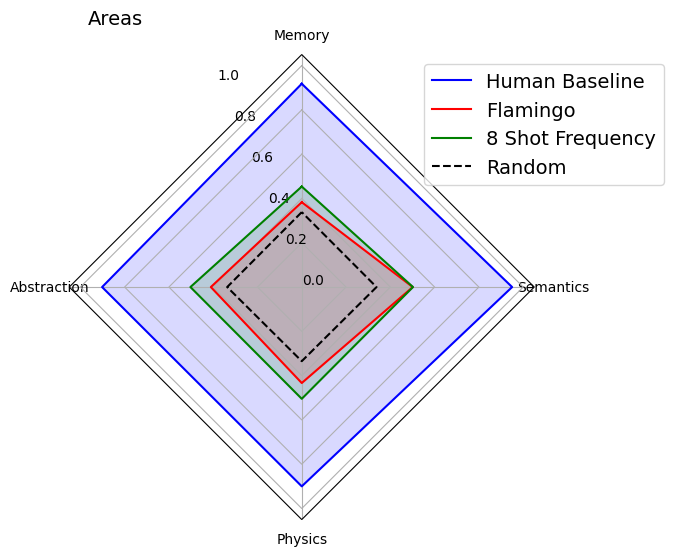

In [14]:
# @title Radar Plot - Areas
exp_baselines = ['Random']

area_title = 'Areas'
area_labels = ['Memory', 'Abstraction',
               'Physics', 'Semantics']
area_results = {
    'Human Baseline': [0.9181818181818181, 0.9017241379310343,
                       0.9, 0.9499999999999997],
    'Flamingo': [0.38321870701513067, 0.4105691056910569,
                 0.4334004361684281, 0.5011517991897688],
    }
area_results['8 Shot Frequency'] = []
area_results['Random'] = []
for area in area_labels:
  area_results['8 Shot Frequency'].append(results['8'][area.lower()])
  area_results['Random'].append(results['0'][area.lower()])

fig_path = 'areas.svg'

radar_plot_pt(area_results, area_labels, area_title, exp_baselines, fig_path)

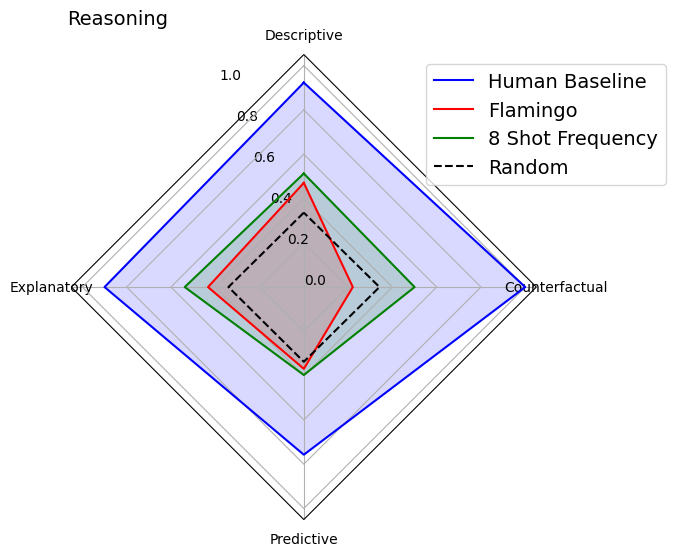

In [15]:
# @title Radar Plot - Reasonings
reasoning_title = 'Reasoning'
reasoning_labels = ['Descriptive', 'Explanatory',
                    'Predictive', 'Counterfactual']
reasoning_results = {
    'Human Baseline': [0.9232323232323233, 0.9,
                       0.7571428571428572, 1.0],
    'Flamingo': [0.47036196241644596, 0.4326334208223972,
                 0.36932707355242567, 0.22128851540616246],
    }
reasoning_results['8 Shot Frequency'] = []
reasoning_results['Random'] = []
for r in reasoning_labels:
  reasoning_results['8 Shot Frequency'].append(results['8'][r.lower()])
  reasoning_results['Random'].append(results['0'][r.lower()])

fig_path = 'reasoning.svg'

radar_plot_pt(reasoning_results, reasoning_labels,
              reasoning_title, exp_baselines, fig_path)

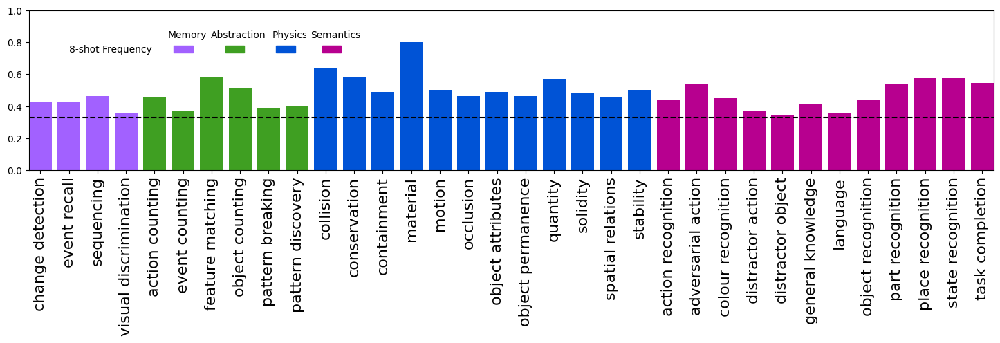

In [16]:
# @title Bar Plot - Tags
fig_path = 'tags.svg'
plot_tags(results['8'], TAG_AREA, fig_path)